In [4]:
import os
import math

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns

%matplotlib inline

In [6]:
dataset_dir = "../dataset"
dataset_path = os.path.join(dataset_dir, "chicago_raw.csv")

crime_df = pd.read_csv(dataset_path)
crime_df.drop_duplicates(subset=['ID', 'Case Number'], inplace=True)

In [7]:
crime_df.drop(['Case Number', 'IUCR','Updated On',
               'Year', 'FBI Code', 'Beat','Ward','Community Area', 'Location'], inplace=True, axis=1)

crime_df.Date = pd.to_datetime(crime_df.Date, format='%m/%d/%Y %I:%M:%S %p')
crime_df.index = pd.DatetimeIndex(crime_df.Date)

In [8]:
crime_df.head(4)

,ID,Date,Block,Primary Type,Description,Location Description,Arrest,Domestic,District,X Coordinate,Y Coordinate,Latitude,Longitude
Date,,,,,,,,,,,,,
2015-01-01,11898582,2015-01-01,058XX W 63RD ST,OFFENSE INVOLVING CHILDREN,AGG CRIM SEX ABUSE FAM MEMBER,PARKING LOT/GARAGE(NON.RESID.),False,False,8.0,NaN,NaN,NaN,NaN
2015-01-01,11772461,2015-01-01,030XX W POLK ST,CRIM SEXUAL ASSAULT,PREDATORY,APARTMENT,True,False,11.0,NaN,NaN,NaN,NaN
2015-01-01,11861892,2015-01-01,021XX E 84TH ST,CRIM SEXUAL ASSAULT,PREDATORY,RESIDENCE,False,False,4.0,NaN,NaN,NaN,NaN
2015-01-01,9993839,2015-01-01,068XX S PAULINA ST,OBSCENITY,SALE/DIST OBSCENE MAT TO MINOR,RESIDENCE,False,True,7.0,1166188.0,1859423.0,41.769832,-87.666383


In [9]:
# take top 20 categories and put the left out categories to OTHER
loc_to_change = list(crime_df["Location Description"].value_counts()[20:].index)
desc_to_change = list(crime_df["Description"].value_counts()[20:].index)

crime_df.loc[crime_df["Location Description"].isin(loc_to_change), "Location Description"] = "OTHER"
crime_df.loc[crime_df["Description"].isin(desc_to_change), "Description"] = "OTHER"

In [10]:
crime_df['Primary Type'] = pd.Categorical(crime_df['Primary Type'])
crime_df['Location Description'] = pd.Categorical(crime_df['Location Description'])
crime_df['Description']          = pd.Categorical(crime_df['Description'])

In [11]:
crime_df.head(3)

,ID,Date,Block,Primary Type,Description,Location Description,Arrest,Domestic,District,X Coordinate,Y Coordinate,Latitude,Longitude
Date,,,,,,,,,,,,,
2015-01-01,11898582,2015-01-01,058XX W 63RD ST,OFFENSE INVOLVING CHILDREN,OTHER,PARKING LOT/GARAGE(NON.RESID.),False,False,8.0,NaN,NaN,NaN,NaN
2015-01-01,11772461,2015-01-01,030XX W POLK ST,CRIM SEXUAL ASSAULT,OTHER,APARTMENT,True,False,11.0,NaN,NaN,NaN,NaN
2015-01-01,11861892,2015-01-01,021XX E 84TH ST,CRIM SEXUAL ASSAULT,OTHER,RESIDENCE,False,False,4.0,NaN,NaN,NaN,NaN


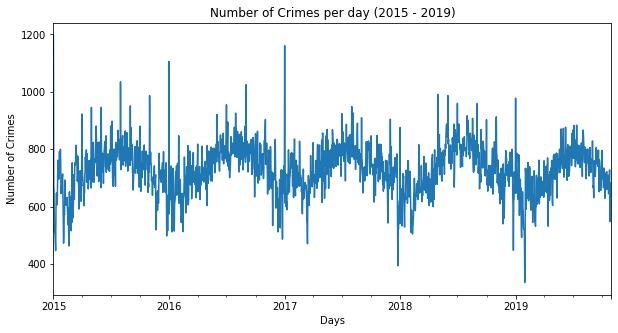

In [10]:
plt.figure(figsize=(10, 5))
crime_df.resample("D").size().plot()
plt.title("Number of Crimes per day (2015 - 2019)")
plt.ylabel("Number of Crimes")
plt.xlabel("Days")
plt.show()

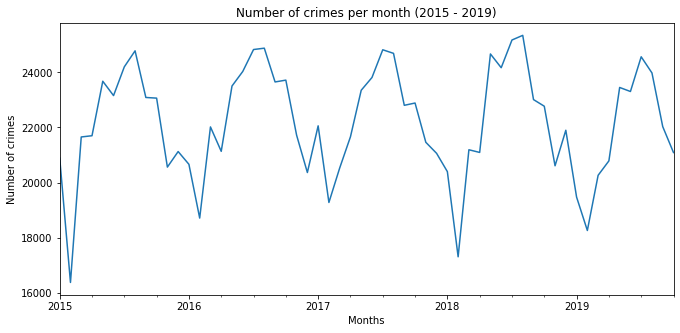

In [11]:
plt.figure(figsize=(11,5))
crime_df.resample('M').size().plot()
plt.title('Number of crimes per month (2015 - 2019)')
plt.xlabel('Months')
plt.ylabel('Number of crimes')
plt.show()

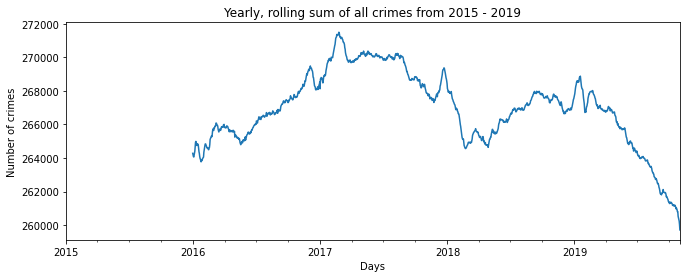

In [12]:
plt.figure(figsize=(11,4))
crime_df.resample('D').size().rolling(365).sum().plot()
plt.title('Yearly, rolling sum of all crimes from 2015 - 2019')
plt.ylabel('Number of crimes')
plt.xlabel('Days')
plt.show()

/home/selim/miniconda3/envs/weather/lib/python3.7/site-packages/pandas/plotting/_matplotlib/tools.py:331: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
/home/selim/miniconda3/envs/weather/lib/python3.7/site-packages/pandas/plotting/_matplotlib/tools.py:331: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():


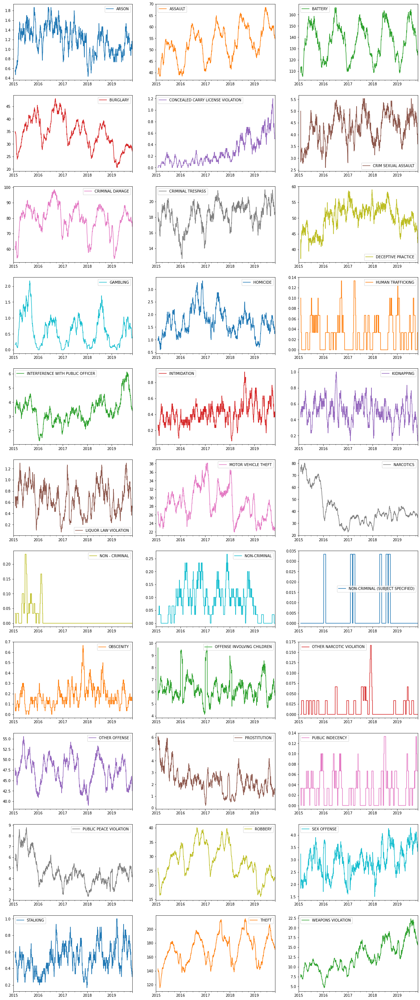

In [12]:
crimes_count_date = crime_df.pivot_table('ID', aggfunc=np.size, columns='Primary Type', index=crime_df.index.date, fill_value=0)
crimes_count_date.index = pd.DatetimeIndex(crimes_count_date.index)
plo = crimes_count_date.rolling(30).mean().plot(figsize=(20, 50), subplots=True, layout=(-1, 3), sharex=False, sharey=False)

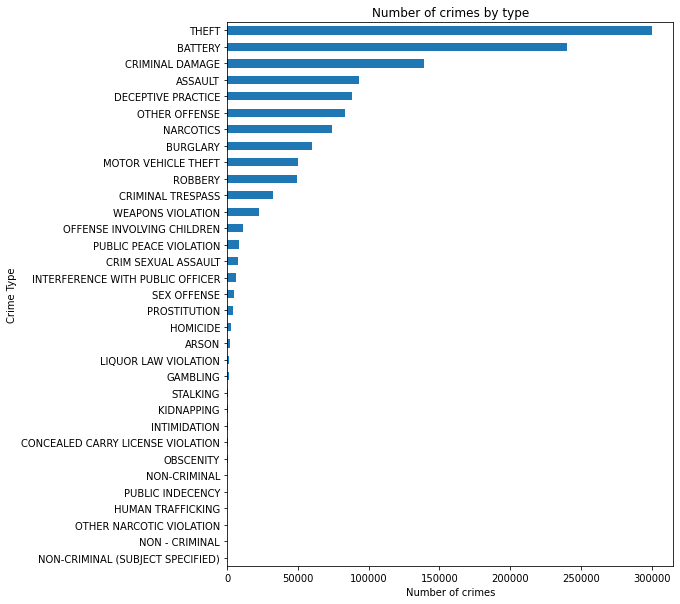

In [14]:
plt.figure(figsize=(8,10))
crime_df.groupby([crime_df['Primary Type']]).size().sort_values(ascending=True).plot(kind='barh')
plt.title('Number of crimes by type')
plt.ylabel('Crime Type')
plt.xlabel('Number of crimes')
plt.show()

In [13]:
# Take top 10 crimes
top10crime_types = list(crime_df["Primary Type"].value_counts()[:10].index)
crime_df = crime_df[crime_df["Primary Type"].isin(top10crime_types)]

## Spatial Analysis

In [14]:
print(crime_df.shape)
print(crime_df["Latitude"].min(), crime_df["Latitude"].max())
print(crime_df["Longitude"].min(), crime_df["Longitude"].max())

coord_range = [[41.60,42.05], [-87.9,-87.5]]  # Lat-Lon
lat_idx = (coord_range[0][0] <= crime_df["Latitude"]) & (crime_df["Latitude"] <= coord_range[0][1])
lon_idx = (coord_range[1][0] <= crime_df["Longitude"]) & (crime_df["Longitude"] <= coord_range[1][1])

crime_df = crime_df[lat_idx & lon_idx]

print(crime_df["Latitude"].min(), crime_df["Latitude"].max())
print(crime_df["Longitude"].min(), crime_df["Longitude"].max())

(1179040, 13)
36.619446395 42.022671246
-91.686565684 -87.524529378
41.644589713 42.022671246
-87.899997933 -87.524529378


In [15]:
def plot_background(ax, coord_range, M=10, N=11):
    background_path = "background/chicago.png"
    x_ticks = np.linspace(coord_range[1][0], coord_range[1][1], N + 1)
    y_ticks = np.linspace(coord_range[0][0], coord_range[0][1], M + 1)

    x_tick_labels = ["{:2.3f}".format(long) for long in x_ticks]
    y_tick_labels = ["{:2.3f}".format(lat) for lat in y_ticks]

    ax.set_xticks(ticks=x_ticks)
    ax.set_xticklabels(labels=x_tick_labels,
                  rotation=30,
                  size=12)
    ax.set_yticks(ticks=y_ticks)
    ax.set_yticklabels(labels=y_tick_labels,
                    size=12)

    ax.spines['top'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)


    img = mpimg.imread(background_path)
    ax.imshow(img,
              interpolation='bilinear',
              extent=[*coord_range[1], *coord_range[0]])
    ax.grid(True)
    return ax



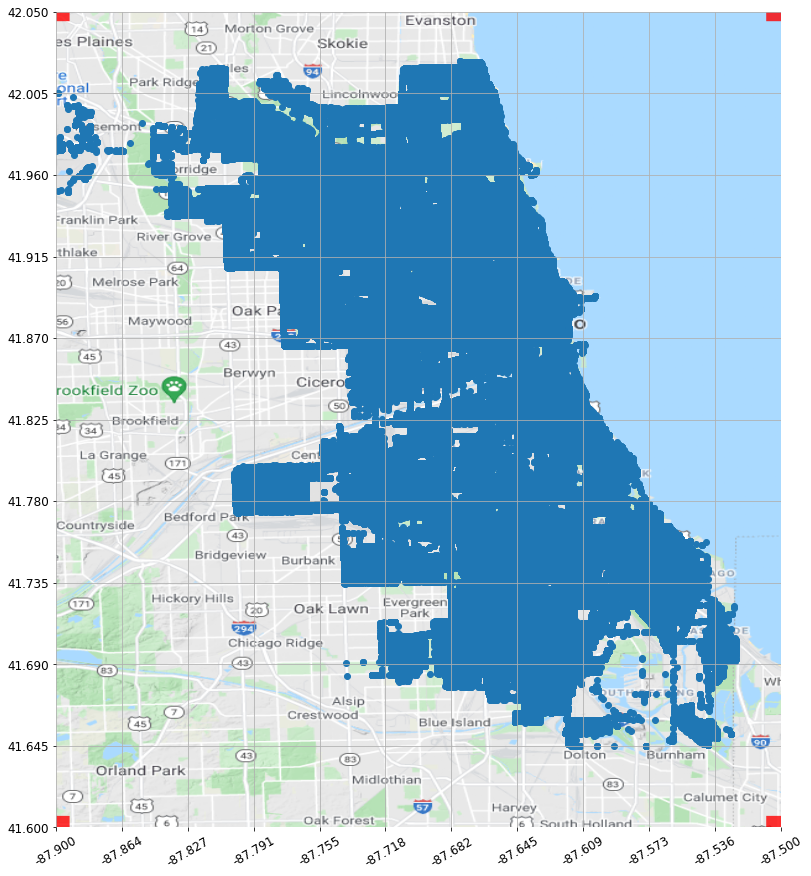

In [16]:
fig, ax = plt.subplots(figsize=(20, 15))
plot_background(ax=ax, coord_range=coord_range)
ax.scatter(crime_df["Longitude"], crime_df["Latitude"])
plt.show()

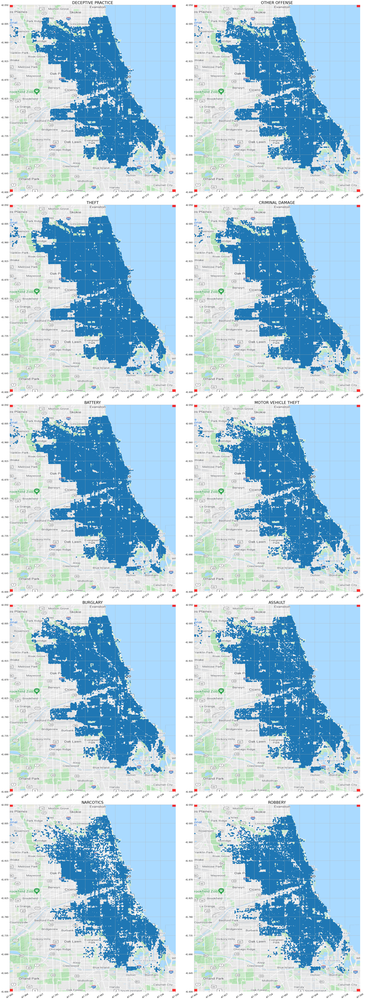

In [17]:
crime_types = list(crime_df["Primary Type"].unique())

fig, ax = plt.subplots(math.ceil(len(crime_types) / 2), 2, figsize=(30, 80))

for i in range(len(crime_types)):
    crime_type = crime_types[i]
    row_idx, col_idx = i // 2, i % 2

    plot_background(ax=ax[row_idx, col_idx], coord_range=coord_range)
    ax[row_idx, col_idx].scatter(crime_df.loc[crime_df["Primary Type"] == crime_type, "Longitude"],
               crime_df.loc[crime_df["Primary Type"] == crime_type, "Latitude"])
    ax[row_idx, col_idx].set_title(crime_type, fontsize=22)
fig.tight_layout()

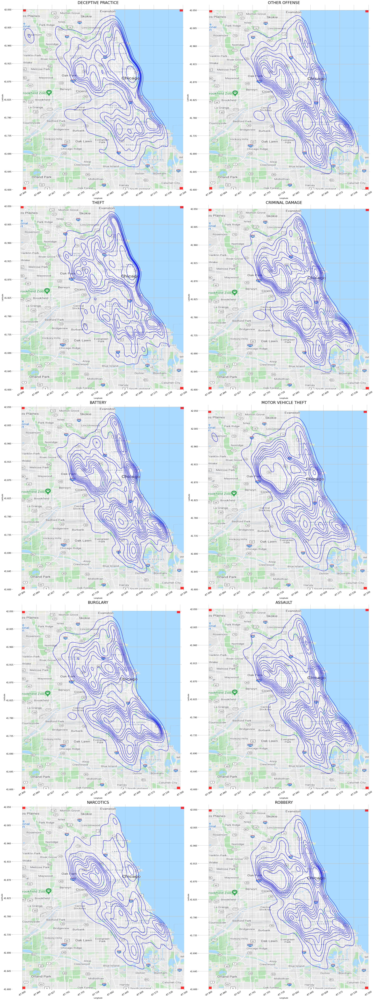

In [23]:
fig, ax = plt.subplots(math.ceil(len(crime_types) / 2), 2, figsize=(30, 80))

for i in range(len(crime_types)):
    crime_type = crime_types[i]
    row_idx, col_idx = i // 2, i % 2

    plot_background(ax=ax[row_idx, col_idx], coord_range=coord_range)
    sns.kdeplot(x=crime_df[crime_df["Primary Type"] == crime_type].Longitude,
                y=crime_df[crime_df["Primary Type"] == crime_type].Latitude, ax=ax[row_idx, col_idx], color='b')
    ax[row_idx, col_idx].set_title(crime_type, fontsize=22)

fig.tight_layout()


In [18]:
def convert_grid(in_df, coord_range, date_range, M=10, N=11):
    x_ticks = np.linspace(coord_range[1][0], coord_range[1][1], N + 1)
    y_ticks = np.linspace(coord_range[0][0], coord_range[0][1], M + 1)

    time_len = len(date_range)

    grid = np.zeros((time_len, M, N))
    for j in range(M):
        for i in range(N):
            lat_idx = (y_ticks[j] < in_df["Latitude"]) & (in_df["Latitude"] <= y_ticks[j+1])
            lon_idx = (x_ticks[i] < in_df["Longitude"]) & (in_df["Longitude"] <= x_ticks[i+1])
            cell_arr = in_df[lat_idx & lon_idx].resample('H').size().reindex(date_range, fill_value=0).values
            grid[:, M-j-1, i] = cell_arr

    return grid

In [19]:
start_date = crime_df.index.min().strftime(format="%Y-%m-%d %H")
end_date = crime_df.index.max().strftime(format="%Y-%m-%d %H")
r = pd.date_range(start=start_date, end=end_date, freq='1H')
r

DatetimeIndex(['2015-01-01 00:00:00', '2015-01-01 01:00:00',
               '2015-01-01 02:00:00', '2015-01-01 03:00:00',
               '2015-01-01 04:00:00', '2015-01-01 05:00:00',
               '2015-01-01 06:00:00', '2015-01-01 07:00:00',
               '2015-01-01 08:00:00', '2015-01-01 09:00:00',
               ...
               '2019-10-31 14:00:00', '2019-10-31 15:00:00',
               '2019-10-31 16:00:00', '2019-10-31 17:00:00',
               '2019-10-31 18:00:00', '2019-10-31 19:00:00',
               '2019-10-31 20:00:00', '2019-10-31 21:00:00',
               '2019-10-31 22:00:00', '2019-10-31 23:00:00'],
              dtype='datetime64[ns]', length=42360, freq='H')

In [20]:
M, N = 50, 33

grid_arr = []
for i in range(len(crime_types)):
    in_df = crime_df[crime_df["Primary Type"] == crime_types[i]]
    print(crime_types[i])
    grid = convert_grid(in_df, coord_range, date_range=r, M=M, N=N)
    grid_arr.append(grid)

grid_arr = np.stack(grid_arr, axis=-1)

DECEPTIVE PRACTICE
OTHER OFFENSE
THEFT
CRIMINAL DAMAGE
BATTERY
MOTOR VEHICLE THEFT
BURGLARY
ASSAULT
NARCOTICS
ROBBERY


In [21]:
grid_arr.shape  #TMND

(42360, 50, 33, 10)

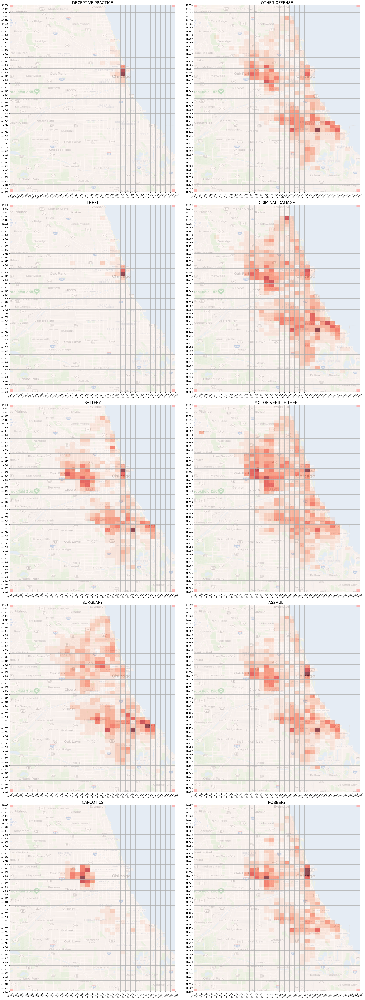

In [22]:
fig, ax = plt.subplots(math.ceil(len(crime_types) / 2), 2, figsize=(30, 80))

for i in range(len(crime_types)):
    crime_type = crime_types[i]
    row_idx, col_idx = i // 2, i % 2
    grid_sum = np.sum(grid_arr[..., i], axis=0)

    plot_background(ax=ax[row_idx, col_idx], coord_range=coord_range, M=M, N=N)
    ax[row_idx, col_idx].imshow(X=grid_sum,
           cmap=plt.cm.get_cmap('Reds', 10),
           interpolation='nearest',
           extent=[*coord_range[1], *coord_range[0]],
           alpha=0.7)
    ax[row_idx, col_idx].set_title(crime_type, fontsize=22)
fig.tight_layout()



## Correlations

In [25]:
plt.style.use('seaborn')

crime_df = crime_df.drop(columns=["Date", "Block", "X Coordinate", "Y Coordinate"])

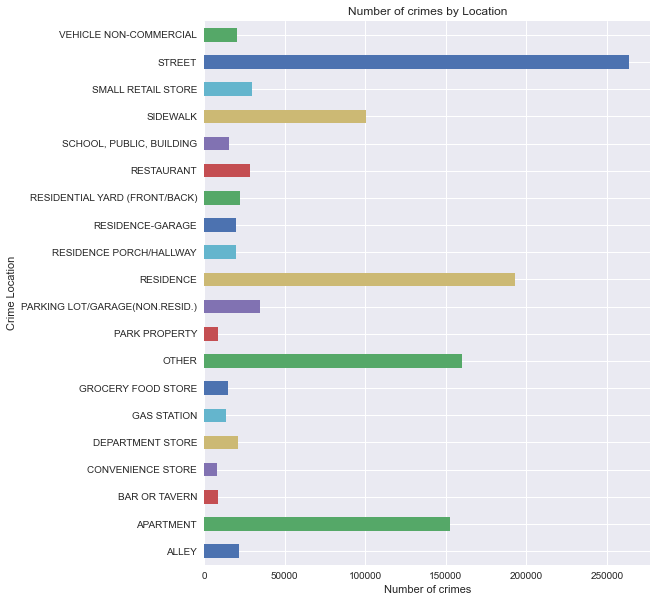

In [26]:
locations = crime_df['Location Description'].unique()
colors = [f"C{i}" for i in range(len(locations))]
plt.figure(figsize=(8,10))
crime_df.groupby([crime_df['Location Description']]).size().plot(kind='barh', color=colors)
plt.title('Number of crimes by Location')
plt.ylabel('Crime Location')
plt.xlabel('Number of crimes')
plt.show()

## Where a certain crime type is most likely to happen?

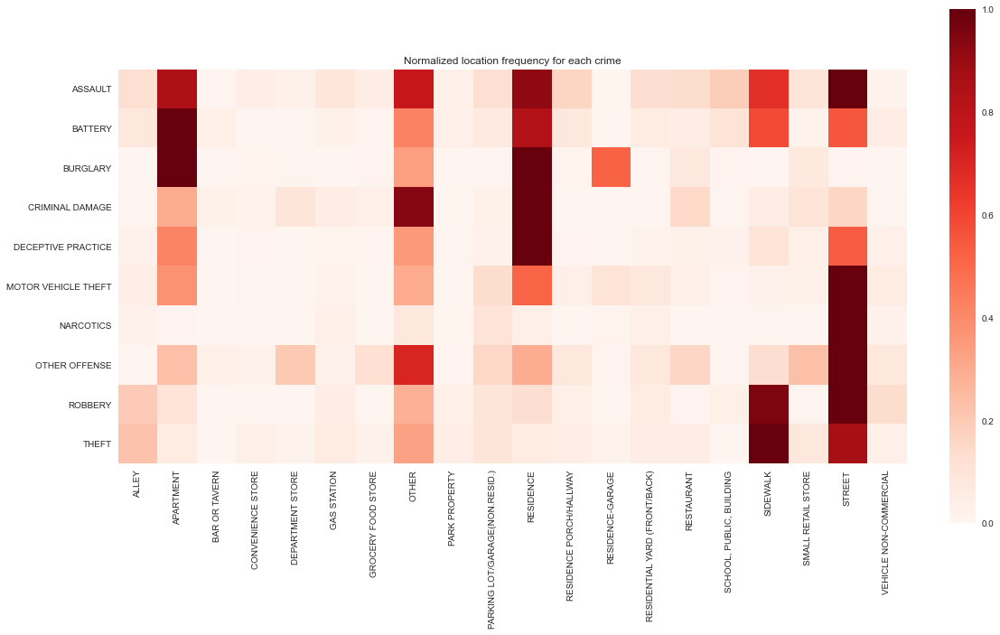

In [28]:
from sklearn.cluster import AgglomerativeClustering as AC

location_by_type  = crime_df.pivot_table(values='ID', index='Location Description', columns='Primary Type', aggfunc=np.size).fillna(0)

result = location_by_type.copy()
for feature_name in location_by_type.columns:
    max_value = location_by_type[feature_name].max()
    min_value = location_by_type[feature_name].min()
    result[feature_name] = (location_by_type[feature_name] - min_value) / (max_value - min_value)


ix = AC(3).fit(result.T).labels_.argsort() # a trick to make better heatmaps
plt.figure(figsize=(17,13))
plt.imshow(result.T.iloc[ix,:], cmap='Reds')
plt.colorbar(fraction=0.03)
plt.xticks(np.arange(result.shape[0]), result.index, rotation='vertical')
plt.yticks(np.arange(result.shape[1]), result.columns)
plt.title('Normalized location frequency for each crime')
plt.grid(False)
plt.show()



## Time Analysis of Crimes

In [29]:
crime_dfs = []
for crime_type in top10crime_types:
    crimes = crime_df[crime_df["Primary Type"] == crime_type].resample('H').size()
    crime_dfs.append(crimes)

In [30]:
crimes = pd.concat(crime_dfs, axis=1).fillna(0)
crimes.columns = top10crime_types

In [31]:
crimes.head(3)

,THEFT,BATTERY,CRIMINAL DAMAGE,ASSAULT,DECEPTIVE PRACTICE,OTHER OFFENSE,NARCOTICS,BURGLARY,MOTOR VEHICLE THEFT,ROBBERY
Date,,,,,,,,,,
2015-01-01 00:00:00,16,12,13,4,37.0,11,0.0,1.0,1,0.0
2015-01-01 01:00:00,8,25,6,1,0.0,5,2.0,1.0,2,0.0
2015-01-01 02:00:00,10,23,8,2,0.0,1,0.0,2.0,1,4.0


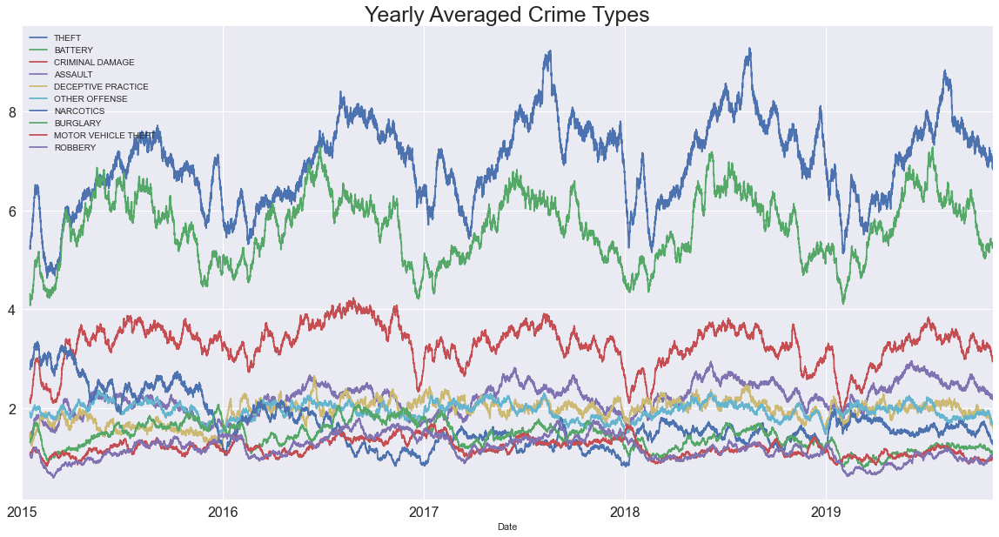

In [32]:
fig, ax = plt.subplots(figsize=(20, 10))
crimes.rolling(365).mean().plot(ax=ax, fontsize=16)
plt.title("Yearly Averaged Crime Types", fontsize=25)
plt.show()

### Monthly behaviour of crimes

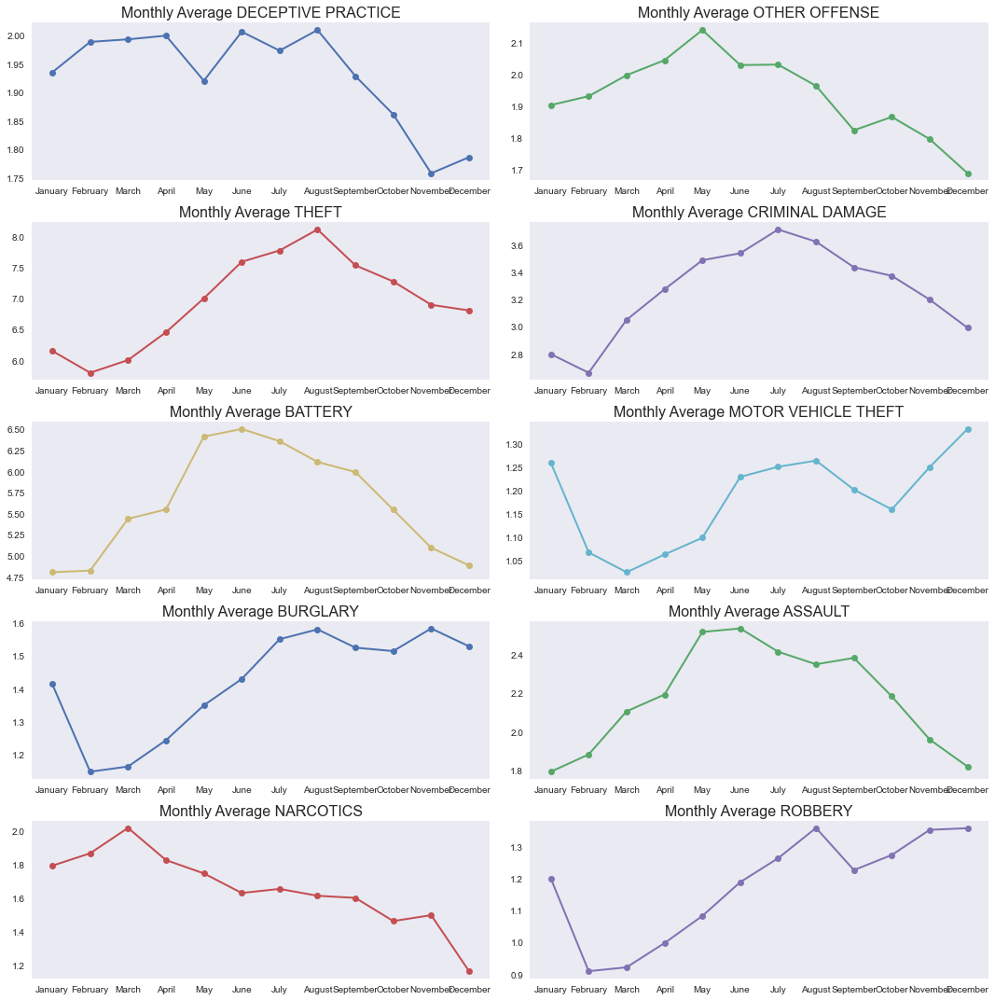

In [33]:
months = ["January", "February", "March", "April", "May", "June",
          "July", "August", "September", "October", "November", "December"]

month_dfs = []
for i in range(12):
    indices = pd.to_datetime(crimes.index).month == i+1
    month_dfs.append(crimes[indices].mean(axis=0))

colors = [f"C{i}" for i in range(len(crime_types))]

fig, axs = plt.subplots(len(crime_types) // 2 , 2, figsize=(15, 15))

for i, col in enumerate(crime_types):
    row_idx, col_idx = i // 2, i % 2

    month_arr = []
    for month_df in month_dfs:
        month_arr.append(month_df[col])

    axs[row_idx, col_idx].plot(range(len(month_arr)), month_arr, '-o', label=col, c=colors[i], lw=2)
    axs[row_idx, col_idx].set_title(f"Monthly Average {col}", fontsize=16)
    axs[row_idx, col_idx].set_xticks(range(len(month_arr)))
    axs[row_idx, col_idx].set_xticklabels(months)
    axs[row_idx, col_idx].grid()
fig.tight_layout()

### Weekly behaviour of crimes

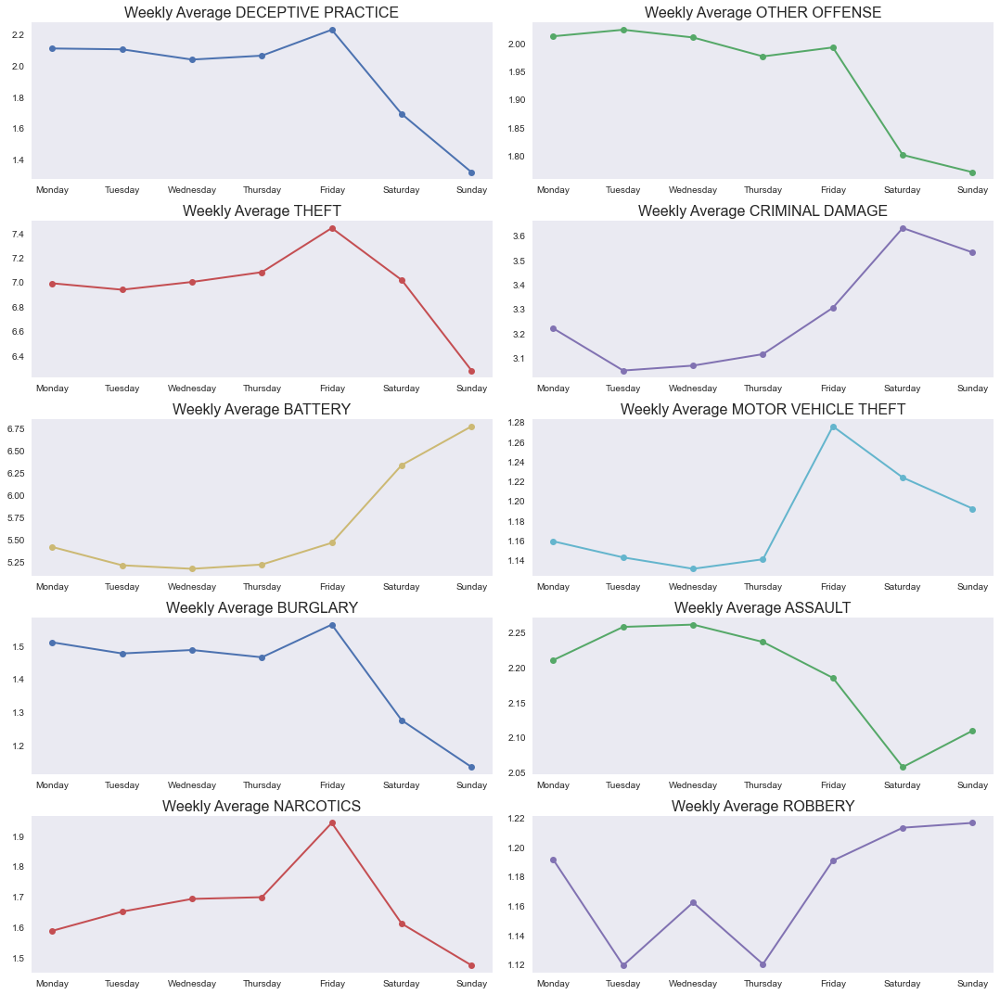

In [34]:
week_days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

week_dfs = []
for week_day in range(7):
    indices = pd.to_datetime(crimes.index).dayofweek == week_day
    week_dfs.append(crimes[indices].mean(axis=0))

colors = [f"C{i}" for i in range(len(crime_types))]


fig, axs = plt.subplots(len(crime_types) // 2 , 2, figsize=(15, 15))

for i, col in enumerate(crime_types):
    row_idx, col_idx = i // 2, i % 2

    week_arr = []
    for week_df in week_dfs:
        week_arr.append(week_df[col])

    axs[row_idx, col_idx].plot(range(len(week_arr)), week_arr, '-o', label=col, c=colors[i], lw=2)
    axs[row_idx, col_idx].set_title(f"Weekly Average {col}", fontsize=16)
    axs[row_idx, col_idx].set_xticks(range(len(week_arr)))
    axs[row_idx, col_idx].set_xticklabels(week_days)
    axs[row_idx, col_idx].grid()
fig.tight_layout()

### Daily behaviour of crimes

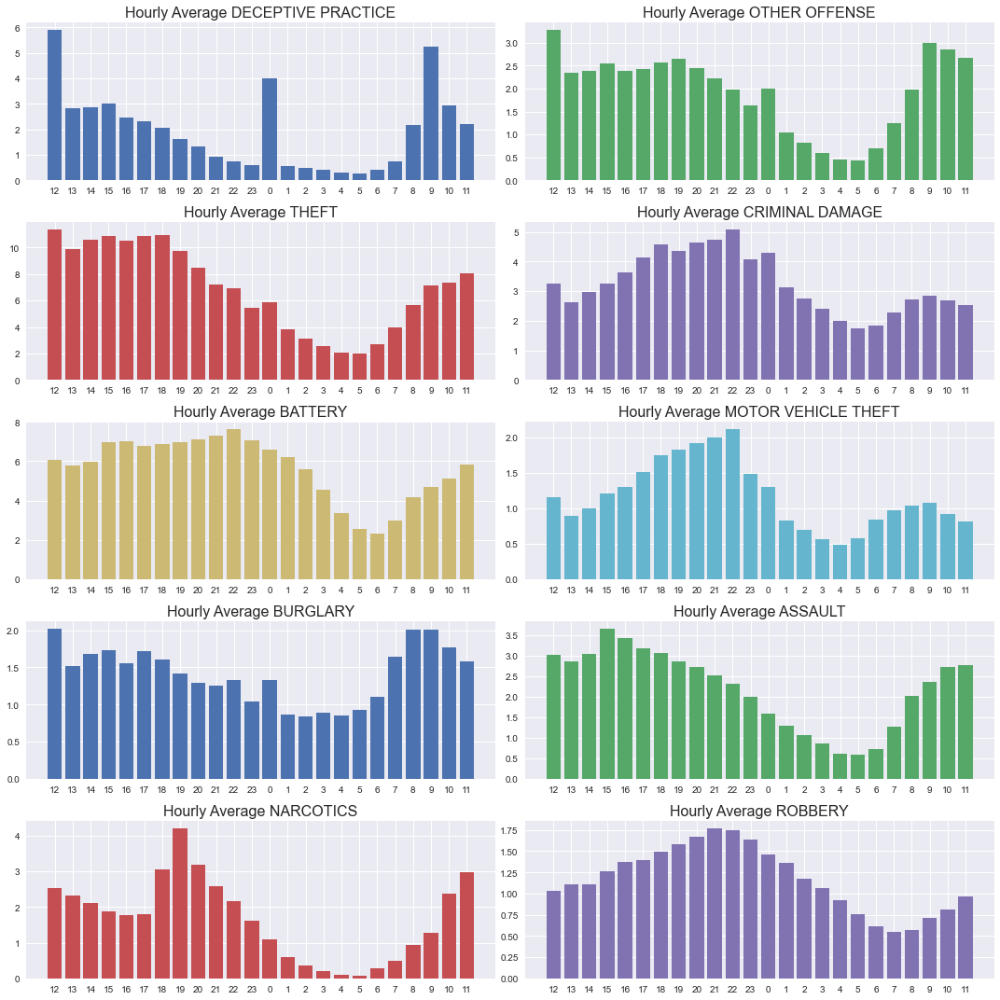

In [35]:
hours = np.arange(24)
hours = list(np.roll(hours, 12))

hour_dfs = []
for hour_idx in hours:
    indices = crimes.index.hour == hour_idx
    hour_dfs.append(crimes[indices].mean(axis=0))
hour_str = [str(h) for h in hours]
    
fig, axs = plt.subplots(len(crime_types) // 2 , 2, figsize=(15, 15))

for i, col in enumerate(crime_types):
    row_idx, col_idx = i // 2, i % 2

    hour_arr = []
    for hour_df in hour_dfs:
        hour_arr.append(hour_df[col])

    axs[row_idx, col_idx].bar(hour_str, hour_arr, color=colors[i])
    axs[row_idx, col_idx].set_title(f"Hourly Average {col}", fontsize=16)
    axs[row_idx, col_idx].set_xticks(hour_str)
    axs[row_idx, col_idx].set_xticklabels([str(h) for h in hours])
fig.tight_layout()


Text(0.5, 1.0, 'Correlation Matrix ULKE')

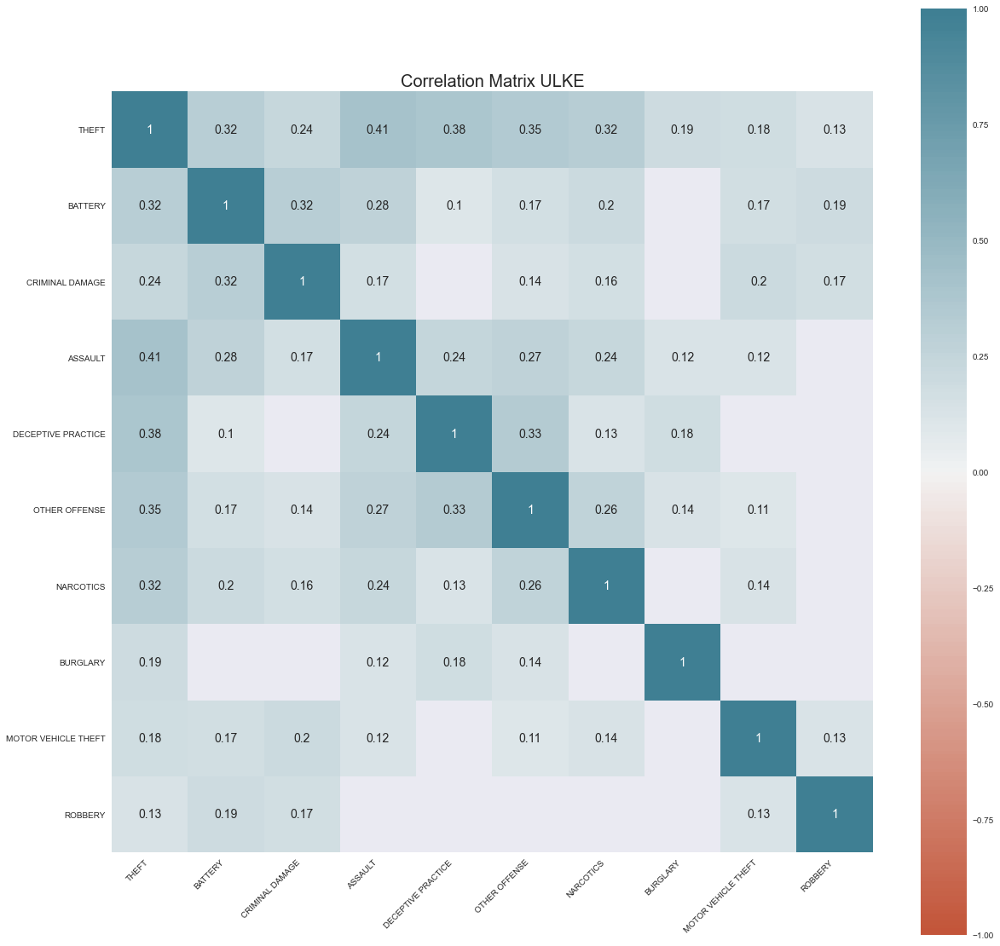

In [36]:
threshold = 0.1

corr = crimes.corr()
corr[np.abs(corr) < threshold] = np.nan


fig, ax = plt.subplots(figsize=(20, 20))
ax = sns.heatmap(
    corr,
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
    annot=True,
    annot_kws={"fontsize":14}
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
)
ax.set_title("Correlation Matrix ULKE", fontsize=20)


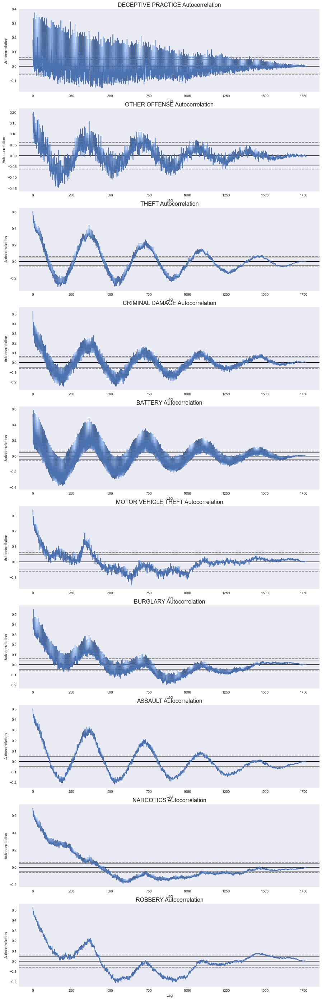

In [37]:
fig, ax = plt.subplots(len(crime_types), 1, figsize=(15, 50))

for i, crime_type in enumerate(crime_types):
    pd.plotting.autocorrelation_plot(crimes[crime_type].resample("D").sum(), ax=ax[i])
    ax[i].set_title(f"{crime_type} Autocorrelation", fontsize=16)

Text(0.5, 1.0, 'PCA for Time Analysis')

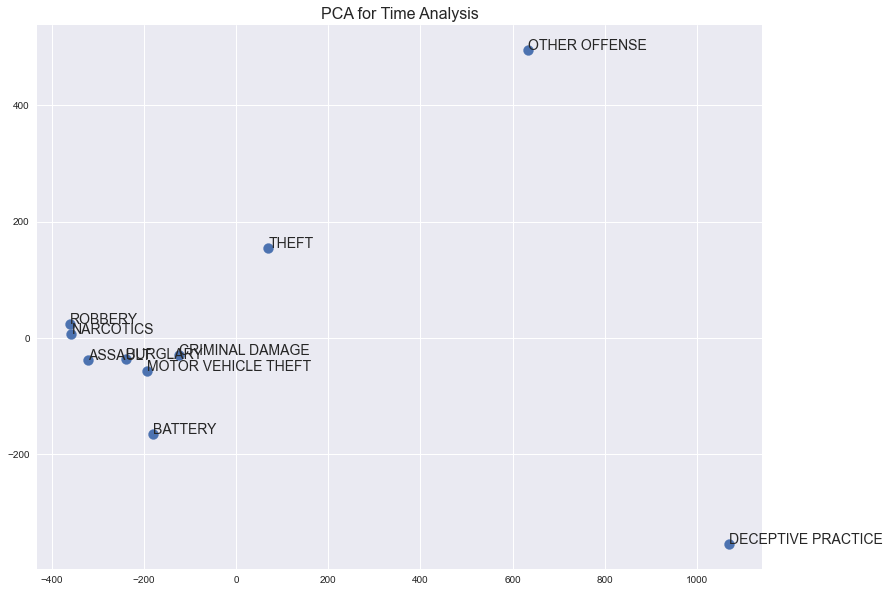

In [38]:
from sklearn import decomposition


crime_arr = crimes.values.T

pca = decomposition.PCA(n_components=2)
pca.fit(crime_arr)
X = pca.transform(crime_arr)

fig, ax = plt.subplots(figsize=(13, 10))
ax.scatter(X[:, 0], X[:, 1], s=100)

for i, txt in enumerate(crime_types):
    ax.annotate(txt, (X[i, 0], X[i, 1]), fontsize=14)

ax.set_title("PCA for Time Analysis", fontsize=16)

## Spatial and Temporal Analysis

In [39]:
grid_arr.shape

(42360, 50, 33, 10)

In [40]:
grid_arr_crimes = np.sum(grid_arr, axis=-1)
grid_arr_crimes.shape

(42360, 50, 33)

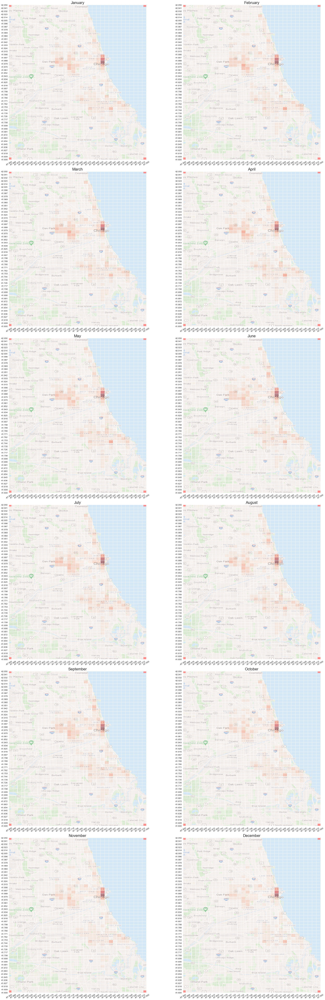

In [41]:
months = ["January", "February", "March", "April", "May", "June",
          "July", "August", "September", "October", "November", "December"]

fig, ax = plt.subplots(math.ceil(len(months) / 2), 2, figsize=(30, 80))

for i, month in enumerate(months):
    month_indices = r.month == i+1
    month_arr = np.sum(grid_arr_crimes[month_indices], axis=0)

    row_idx, col_idx = i // 2, i % 2
    plot_background(ax=ax[row_idx, col_idx], coord_range=coord_range, M=M, N=N)
    ax[row_idx, col_idx].imshow(X=month_arr,
                                cmap=plt.cm.get_cmap('Reds', 10),
                                interpolation='nearest',
                                extent=[*coord_range[1], *coord_range[0]],
                                alpha=0.5)
    ax[row_idx, col_idx].set_title(month, fontsize=22)
fig.tight_layout()
plt.show()

In [42]:
grid_arr_daily = np.split(grid_arr, len(grid_arr) / 24)
grid_arr_daily = np.stack([np.sum(arr, axis=0) for arr in grid_arr_daily])
grid_arr_daily.shape

(1765, 50, 33, 10)

In [43]:
grid_arr_daily[0, ..., 0]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

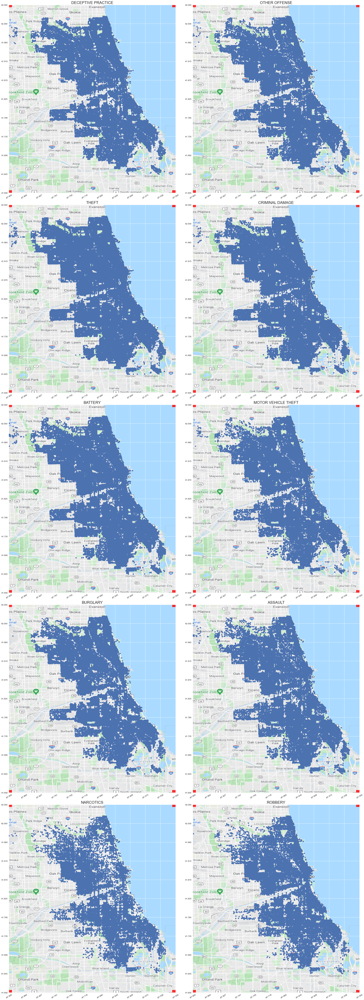

In [45]:
crime_types = list(crime_df["Primary Type"].unique())

fig, ax = plt.subplots(math.ceil(len(crime_types) / 2), 2, figsize=(30, 80))

for i in range(len(crime_types)):
    crime_type = crime_types[i]
    row_idx, col_idx = i // 2, i % 2

    plot_background(ax=ax[row_idx, col_idx], coord_range=coord_range)
    ax[row_idx, col_idx].scatter(crime_df.loc[crime_df["Primary Type"] == crime_type, "Longitude"],
               crime_df.loc[crime_df["Primary Type"] == crime_type, "Latitude"])
    ax[row_idx, col_idx].set_title(crime_type, fontsize=22)
fig.tight_layout()

In [ ]:
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

dpi=150
grid_arr_daily[grid_arr_daily > 0] = 1
save_dir= "figs"
fig = plt.figure("sd", figsize=(10, 8))
for day in range(len(grid_arr_daily)):
    print(f"{day} / {len(grid_arr_daily)}")
    grid_features = grid_arr_daily[day]
    for i in range(len(crime_types)):
        crime_type = crime_types[i]
        grid = grid_features[..., i]

        ax = fig.add_subplot()
        plot_background(ax=ax, coord_range=coord_range, M=M, N=N)
        plt.imshow(X=grid,
                  cmap=plt.cm.get_cmap('Reds', 10),
                  interpolation='nearest', 
                  extent=[*coord_range[1], *coord_range[0]], alpha=0.5)
        plt.title(crime_type, fontsize=22)
        save_path = os.path.join(save_dir, f"{crime_type}_{day}.png")
        fig.savefig(save_path, dpi=dpi, bbox_inches='tight', facecolor='white', transparent=False)
        fig.clf()
        plt.figure(fig.number)

0 / 1765
1 / 1765
2 / 1765
3 / 1765
4 / 1765
5 / 1765
6 / 1765
7 / 1765
8 / 1765
9 / 1765
10 / 1765
11 / 1765
12 / 1765
13 / 1765
14 / 1765
15 / 1765
16 / 1765
17 / 1765
18 / 1765
19 / 1765
20 / 1765
21 / 1765
22 / 1765
23 / 1765
24 / 1765
25 / 1765
26 / 1765
27 / 1765
28 / 1765
29 / 1765
30 / 1765
31 / 1765
32 / 1765
33 / 1765
34 / 1765
35 / 1765
36 / 1765
37 / 1765
38 / 1765
39 / 1765
40 / 1765
41 / 1765
42 / 1765
43 / 1765
44 / 1765
45 / 1765
46 / 1765
47 / 1765
48 / 1765
49 / 1765
50 / 1765
51 / 1765
52 / 1765
53 / 1765
54 / 1765
55 / 1765
56 / 1765
57 / 1765
58 / 1765
59 / 1765
60 / 1765
61 / 1765
62 / 1765
63 / 1765
64 / 1765
65 / 1765
66 / 1765
67 / 1765
68 / 1765
69 / 1765
70 / 1765
71 / 1765
72 / 1765
73 / 1765
74 / 1765
75 / 1765
76 / 1765
77 / 1765
78 / 1765
79 / 1765
80 / 1765
81 / 1765
82 / 1765
83 / 1765
84 / 1765
85 / 1765
86 / 1765
87 / 1765
88 / 1765
89 / 1765
90 / 1765
91 / 1765
92 / 1765
93 / 1765
94 / 1765
95 / 1765
96 / 1765
97 / 1765
98 / 1765
99 / 1765
100 / 1765

In [25]:
import glob
import imageio

figs_folder = "figs"
gifs_folder = "gifs"

if not os.path.exists(gifs_folder):
    os.makedirs(gifs_folder)


for crime_type in crime_types:
    file_paths = list(glob.glob(os.path.join(figs_folder, f"{crime_type}*")))
    file_order = [int(f.split(".")[0].split("_")[-1]) for f in file_paths]
    file_order = np.argsort(np.array(file_order))
    file_paths_arr = np.array(file_paths)[file_order]

    with imageio.get_writer(os.path.join(gifs_folder, f'{crime_type}.gif'), mode='I') as writer:
        for filename in file_paths_arr:
            image = imageio.imread(filename)
            writer.append_data(image)



<img src="THEFT.gif" width="300" align="left">

<img src="BATTERY.gif" width="300" align="center">

<img src="MOTOR VEHICLE THEFT.gif" width="300" align="left">

<img src="CRIMINAL DAMAGE.gif" width="300" align="center">

In [47]:
grid_arr_crimes.shape, len(r)

((42360, 10, 11), 42360)

In [54]:
cell_arr = grid_arr_crimes.reshape(len(r), -1)
sum_cells = np.sum(cell_arr, axis=0)

top_indices = np.argsort(sum_cells)[::-1]
sorted_cells = sum_cells[top_indices]

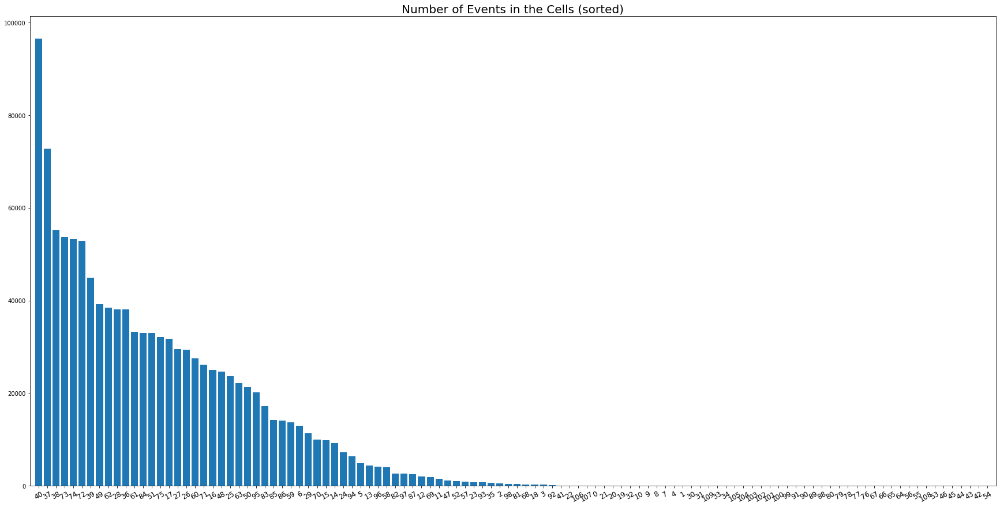

In [78]:
top_indices_str = [str(i) for i in top_indices]
plt.figure(figsize=(30, 15))
plt.bar(range(len(sorted_cells)), sorted_cells)
plt.xticks(range(len(sorted_cells)), [str(h) for h in top_indices],
          rotation=30,
          size=12)
plt.xlim(-1, len(sorted_cells))
plt.title("Number of Events in the Cells (sorted)", fontsize=20)
plt.show()

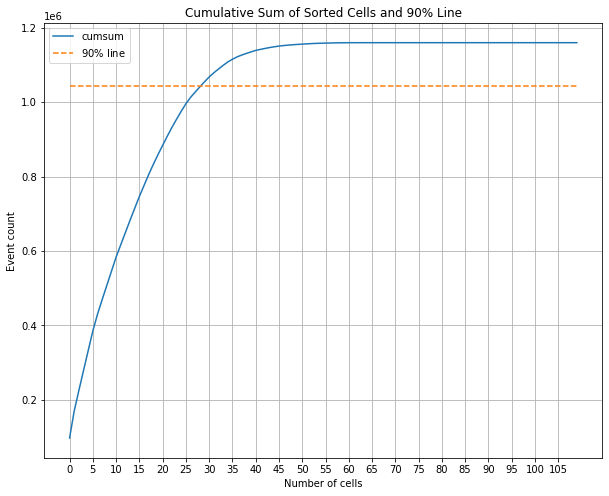

In [94]:
cumsum = np.cumsum(sorted_cells)
ninety_percent_line = np.repeat(np.floor(np.sum(sum_cells) * 0.9), len(sorted_cells))

plt.figure(figsize=(10, 8))
plt.plot(range(len(cumsum)), cumsum, label="cumsum")
plt.plot(range(len(sorted_cells)), ninety_percent_line, '--', label="$90\%$ line")
plt.xticks(range(0, len(cumsum), 5))
plt.legend()
plt.grid(True)
plt.xlabel("Number of cells")
plt.ylabel("Event count")
plt.title("Cumulative Sum of Sorted Cells and 90% Line")
plt.show()

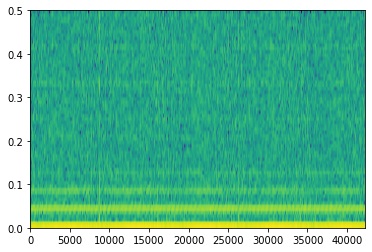

In [154]:
fig, ax = plt.subplots()
im = ax.specgram(np.sum(top20_cells, axis=-1), Fs=1, NFFT=128, noverlap=0)
plt.show()

In [128]:
top20_idx = top_indices[:20]
top20_cells = cell_arr[:, top20_idx]

top20_df = pd.DataFrame(top20_cells, columns=["top" + str(i) for i in range(20)], index=r)
top20_df.head(3)

,top0,top1,top2,top3,top4,top5,top6,top7,top8,top9,top10,top11,top12,top13,top14,top15,top16,top17,top18,top19
2015-01-01 00:00:00,9.0,3.0,6.0,5.0,4.0,4.0,2.0,4.0,1.0,4.0,2.0,0.0,4.0,5.0,1.0,3.0,2.0,1.0,4.0,0.0
2015-01-01 01:00:00,6.0,3.0,1.0,0.0,2.0,4.0,1.0,0.0,1.0,6.0,2.0,1.0,0.0,2.0,0.0,0.0,1.0,6.0,2.0,1.0
2015-01-01 02:00:00,7.0,3.0,3.0,4.0,2.0,3.0,2.0,0.0,0.0,2.0,4.0,1.0,0.0,1.0,1.0,1.0,3.0,1.0,0.0,1.0


Text(0.5, 1.0, 'Correlation Matrix Top20')

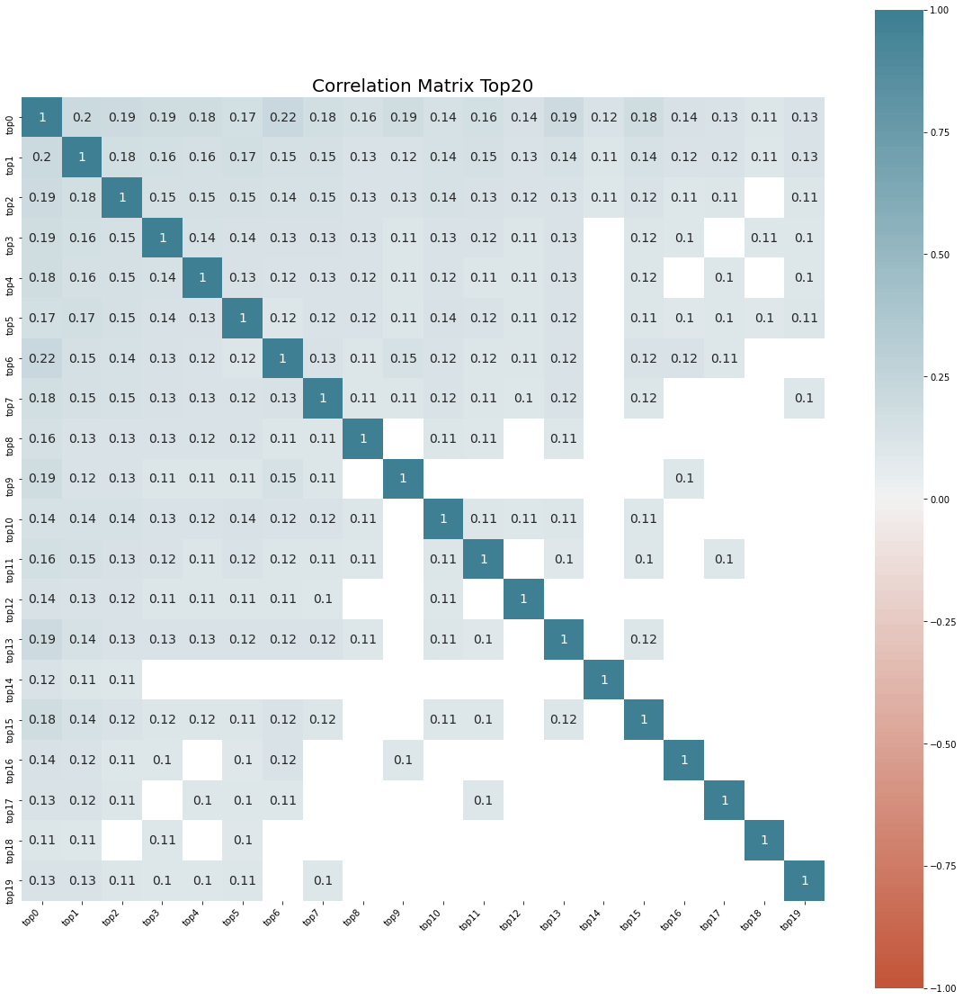

In [145]:
corr = top20_df.corr()
corr[np.abs(corr) < 0.1] = np.nan


fig, ax = plt.subplots(figsize=(20, 20))
ax = sns.heatmap(
    corr,
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
    annot=True,
    annot_kws={"fontsize":14}
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
)
ax.set_title("Correlation Matrix Top20", fontsize=20)


# Weather Analysis

In [31]:
weather_df = pd.read_csv("chicago_weather.csv", index_col=0)
# pd.DatetimeIndex(weather_df.index, freq="H")
weather_df.head(5)

,t2m,msl,sp,tp
2015-01-01 00:00:00,269.089036,102274.151148,99728.795010,0.000046
2015-01-02 00:00:00,269.002946,102275.185577,99729.397288,0.000046
2015-01-01 01:00:00,268.916856,102276.220006,99729.999566,0.000043
2015-01-02 01:00:00,268.859874,102276.303298,99729.760777,0.000040
2015-01-01 02:00:00,268.802891,102276.386590,99729.521989,0.000047


In [27]:
crimes.head(3)

,THEFT,BATTERY,CRIMINAL DAMAGE,ASSAULT,DECEPTIVE PRACTICE,OTHER OFFENSE,NARCOTICS,BURGLARY,MOTOR VEHICLE THEFT,ROBBERY
Date,,,,,,,,,,
2015-01-01 00:00:00,16,12,13,4,37.0,11,0.0,1.0,1,0.0
2015-01-01 01:00:00,8,25,6,1,0.0,5,2.0,1.0,2,0.0
2015-01-01 02:00:00,10,23,8,2,0.0,1,0.0,2.0,1,4.0


In [29]:
end_date = crimes.index[-1]
weather_df.loc[weather_df.index < end_date]

TypeError: '<=' not supported between instances of 'str' and 'Timestamp'